# **Time Series Analysis** _Day 124_
##### Name: Muhammad Hassaan
##### Date: August 29, 2024
##### Email: muhammadhassaan7896@gmail.com

# Time Series Data Analysis for Weather Forecasting

* In this notebook, we will explore time series data analysis techniques applied to weather forecasting. Weather data, which is inherently sequential and temporal, can be analyzed using various statistical and machine learning methods to predict future conditions.

* We will start by exploring the dataset, performing data cleaning and preprocessing steps, followed by visualizing key patterns and trends. Next, we will delve into different models such as ARIMA, Prophet, and LSTM to forecast weather conditions. The goal is to build a predictive model that can accurately forecast weather based on historical data, providing insights into temperature, precipitation, and other atmospheric variables.

* Through this project, we aim to understand the complexities of time series data and demonstrate effective forecasting techniques in the context of meteorology.


In [23]:
# import libraries
import os 
import datetime
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.pylab import rcParams
import seaborn as sns 
import plotly.express as px 
import plotly.graph_objects as go
from plotly.subplots import make_subplots
from statsmodels.tsa.seasonal import seasonal_decompose

# import tensorflow
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.layers import Dense, LSTM
from tensorflow.keras.models import Sequential

In [24]:
# managing figure size in the beginning of the code
rcParams['figure.figsize'] = 15,6
rcParams['axes.grid'] = False

In [25]:
# import dataset
zip_path = tf.keras.utils.get_file(
    origin='https://storage.googleapis.com/tensorflow/tf-keras-datasets/jena_climate_2009_2016.csv.zip',
    fname='jena_climate_2009_2016.csv.zip',
    extract=True
)

csv_path, _ = os.path.splitext(zip_path)

In [26]:
# read the data in pandas 
df = pd.read_csv(csv_path)

# print the first 5 rows
df.head()

,Date Time,p (mbar),T (degC),Tpot (K),Tdew (degC),rh (%),VPmax (mbar),VPact (mbar),VPdef (mbar),sh (g/kg),H2OC (mmol/mol),rho (g/m**3),wv (m/s),max. wv (m/s),wd (deg)
0,01.01.2009 00:10:00,996.52,-8.02,265.40,-8.90,93.3,3.33,3.11,0.22,1.94,3.12,1307.75,1.03,1.75,152.3
1,01.01.2009 00:20:00,996.57,-8.41,265.01,-9.28,93.4,3.23,3.02,0.21,1.89,3.03,1309.80,0.72,1.50,136.1
2,01.01.2009 00:30:00,996.53,-8.51,264.91,-9.31,93.9,3.21,3.01,0.20,1.88,3.02,1310.24,0.19,0.63,171.6
3,01.01.2009 00:40:00,996.51,-8.31,265.12,-9.07,94.2,3.26,3.07,0.19,1.92,3.08,1309.19,0.34,0.50,198.0
4,01.01.2009 00:50:00,996.51,-8.27,265.15,-9.04,94.1,3.27,3.08,0.19,1.92,3.09,1309.00,0.32,0.63,214.3


In [27]:
# save the csv file 
# df.to_csv('./data/jena_climate_2009_2016.csv')

In [28]:
# summary statistics of data
df.describe().T

,count,mean,std,min,25%,50%,75%,max
p (mbar),420551.0,989.212776,8.358481,913.60,984.20,989.58,994.72,1015.35
T (degC),420551.0,9.450147,8.423365,-23.01,3.36,9.42,15.47,37.28
Tpot (K),420551.0,283.492743,8.504471,250.60,277.43,283.47,289.53,311.34
Tdew (degC),420551.0,4.955854,6.730674,-25.01,0.24,5.22,10.07,23.11
rh (%),420551.0,76.008259,16.476175,12.95,65.21,79.30,89.40,100.00
VPmax (mbar),420551.0,13.576251,7.739020,0.95,7.78,11.82,17.60,63.77
VPact (mbar),420551.0,9.533756,4.184164,0.79,6.21,8.86,12.35,28.32
VPdef (mbar),420551.0,4.042412,4.896851,0.00,0.87,2.19,5.30,46.01
sh (g/kg),420551.0,6.022408,2.656139,0.50,3.92,5.59,7.80,18.13
H2OC (mmol/mol),420551.0,9.640223,4.235395,0.80,6.29,8.96,12.49,28.82


In [29]:
# info of the data
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 420551 entries, 0 to 420550
Data columns (total 15 columns):
 #   Column           Non-Null Count   Dtype  
---  ------           --------------   -----  
 0   Date Time        420551 non-null  object 
 1   p (mbar)         420551 non-null  float64
 2   T (degC)         420551 non-null  float64
 3   Tpot (K)         420551 non-null  float64
 4   Tdew (degC)      420551 non-null  float64
 5   rh (%)           420551 non-null  float64
 6   VPmax (mbar)     420551 non-null  float64
 7   VPact (mbar)     420551 non-null  float64
 8   VPdef (mbar)     420551 non-null  float64
 9   sh (g/kg)        420551 non-null  float64
 10  H2OC (mmol/mol)  420551 non-null  float64
 11  rho (g/m**3)     420551 non-null  float64
 12  wv (m/s)         420551 non-null  float64
 13  max. wv (m/s)    420551 non-null  float64
 14  wd (deg)         420551 non-null  float64
dtypes: float64(14), object(1)
memory usage: 48.1+ MB


In [30]:
# shape of the data
df.shape

(420551, 15)

In [31]:
df.head(100)

,Date Time,p (mbar),T (degC),Tpot (K),Tdew (degC),rh (%),VPmax (mbar),VPact (mbar),VPdef (mbar),sh (g/kg),H2OC (mmol/mol),rho (g/m**3),wv (m/s),max. wv (m/s),wd (deg)
0,01.01.2009 00:10:00,996.52,-8.02,265.40,-8.90,93.3,3.33,3.11,0.22,1.94,3.12,1307.75,1.03,1.75,152.3
1,01.01.2009 00:20:00,996.57,-8.41,265.01,-9.28,93.4,3.23,3.02,0.21,1.89,3.03,1309.80,0.72,1.50,136.1
2,01.01.2009 00:30:00,996.53,-8.51,264.91,-9.31,93.9,3.21,3.01,0.20,1.88,3.02,1310.24,0.19,0.63,171.6
3,01.01.2009 00:40:00,996.51,-8.31,265.12,-9.07,94.2,3.26,3.07,0.19,1.92,3.08,1309.19,0.34,0.50,198.0
4,01.01.2009 00:50:00,996.51,-8.27,265.15,-9.04,94.1,3.27,3.08,0.19,1.92,3.09,1309.00,0.32,0.63,214.3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95,01.01.2009 16:00:00,999.94,-5.40,267.76,-6.86,89.4,4.08,3.65,0.43,2.27,3.65,1299.17,1.40,2.13,145.5
96,01.01.2009 16:10:00,1000.05,-5.31,267.85,-6.69,89.9,4.11,3.69,0.42,2.30,3.69,1298.81,1.03,1.50,127.0
97,01.01.2009 16:20:00,1000.05,-5.28,267.88,-6.68,89.8,4.12,3.70,0.42,2.30,3.70,1298.69,1.11,1.88,134.7
98,01.01.2009 16:30:00,1000.10,-5.32,267.83,-6.77,89.5,4.11,3.67,0.43,2.29,3.67,1298.96,1.35,2.13,132.3


In [32]:
df.tail(100)

,Date Time,p (mbar),T (degC),Tpot (K),Tdew (degC),rh (%),VPmax (mbar),VPact (mbar),VPdef (mbar),sh (g/kg),H2OC (mmol/mol),rho (g/m**3),wv (m/s),max. wv (m/s),wd (deg)
420451,31.12.2016 07:30:00,1006.34,-6.26,266.42,-9.32,78.70,3.82,3.01,0.81,1.86,2.99,1311.97,1.20,1.68,163.9
420452,31.12.2016 07:40:00,1006.26,-6.35,266.33,-8.62,83.80,3.79,3.18,0.61,1.97,3.16,1312.27,0.60,1.16,145.7
420453,31.12.2016 07:50:00,1006.29,-6.46,266.22,-8.80,83.30,3.76,3.13,0.63,1.94,3.11,1312.85,0.50,1.04,184.1
420454,31.12.2016 08:00:00,1006.28,-6.80,265.89,-8.85,85.20,3.67,3.12,0.54,1.93,3.10,1314.51,0.74,1.76,178.1
420455,31.12.2016 08:10:00,1006.22,-6.84,265.85,-8.71,86.40,3.65,3.16,0.50,1.95,3.14,1314.62,0.95,1.90,181.1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
420546,31.12.2016 23:20:00,1000.07,-4.05,269.10,-8.13,73.10,4.52,3.30,1.22,2.06,3.30,1292.98,0.67,1.52,240.0
420547,31.12.2016 23:30:00,999.93,-3.35,269.81,-8.06,69.71,4.77,3.32,1.44,2.07,3.32,1289.44,1.14,1.92,234.3
420548,31.12.2016 23:40:00,999.82,-3.16,270.01,-8.21,67.91,4.84,3.28,1.55,2.05,3.28,1288.39,1.08,2.00,215.2
420549,31.12.2016 23:50:00,999.81,-4.23,268.94,-8.53,71.80,4.46,3.20,1.26,1.99,3.20,1293.56,1.49,2.16,225.8


In [33]:
# select the data based on the date time column for every 2 hours interval
df = df[11::12]
df.head()

,Date Time,p (mbar),T (degC),Tpot (K),Tdew (degC),rh (%),VPmax (mbar),VPact (mbar),VPdef (mbar),sh (g/kg),H2OC (mmol/mol),rho (g/m**3),wv (m/s),max. wv (m/s),wd (deg)
11,01.01.2009 02:00:00,996.62,-8.88,264.54,-9.77,93.2,3.12,2.90,0.21,1.81,2.91,1312.25,0.25,0.63,190.3
23,01.01.2009 04:00:00,996.99,-9.05,264.34,-10.02,92.6,3.07,2.85,0.23,1.78,2.85,1313.61,0.10,0.38,240.0
35,01.01.2009 06:00:00,997.71,-9.67,263.66,-10.62,92.7,2.93,2.71,0.21,1.69,2.72,1317.71,0.05,0.50,146.0
47,01.01.2009 08:00:00,999.17,-8.10,265.12,-9.05,92.8,3.31,3.07,0.24,1.92,3.08,1311.65,0.72,1.25,213.9
59,01.01.2009 10:00:00,1000.27,-7.04,266.10,-8.17,91.6,3.60,3.30,0.30,2.05,3.29,1307.76,1.45,3.00,292.6


In [34]:
df.shape

(35045, 15)

In [35]:
date_time = pd.to_datetime(df.pop('Date Time'), format='%d.%m.%Y %H:%M:%S')
df.head()

,p (mbar),T (degC),Tpot (K),Tdew (degC),rh (%),VPmax (mbar),VPact (mbar),VPdef (mbar),sh (g/kg),H2OC (mmol/mol),rho (g/m**3),wv (m/s),max. wv (m/s),wd (deg)
11,996.62,-8.88,264.54,-9.77,93.2,3.12,2.90,0.21,1.81,2.91,1312.25,0.25,0.63,190.3
23,996.99,-9.05,264.34,-10.02,92.6,3.07,2.85,0.23,1.78,2.85,1313.61,0.10,0.38,240.0
35,997.71,-9.67,263.66,-10.62,92.7,2.93,2.71,0.21,1.69,2.72,1317.71,0.05,0.50,146.0
47,999.17,-8.10,265.12,-9.05,92.8,3.31,3.07,0.24,1.92,3.08,1311.65,0.72,1.25,213.9
59,1000.27,-7.04,266.10,-8.17,91.6,3.60,3.30,0.30,2.05,3.29,1307.76,1.45,3.00,292.6


In [36]:
df.columns

Index(['p (mbar)', 'T (degC)', 'Tpot (K)', 'Tdew (degC)', 'rh (%)',
       'VPmax (mbar)', 'VPact (mbar)', 'VPdef (mbar)', 'sh (g/kg)',
       'H2OC (mmol/mol)', 'rho (g/m**3)', 'wv (m/s)', 'max. wv (m/s)',
       'wd (deg)'],
      dtype='object')

In [37]:
# # lets plot the `T ()degC` and `p(mbar)` using plotly also extract features and make subplots
# # Create a scatter plot using Plotly Express
# fig = px.scatter(df, x='T (degC)', y='p (mbar)', title='Temperature vs. Pressure')

# # Extract features from the data (e.g., mean, std, correlation coefficient)
# mean_T = df['T (degC)'].mean()
# std_T = df['T (degC)'].std()
# mean_p = df['p (mbar)'].mean()
# std_p = df['p (mbar)'].std()
# corr_coef = df['T (degC)'].corr(df['p (mbar)'])

# print(f'Mean Temperature: {mean_T:.2f} degC')
# print(f'Std Dev Temperature: {std_T:.2f} degC')
# print(f'Mean Pressure: {mean_p:.2f} mbar')
# print(f'Std Dev Pressure: {std_p:.2f} mbar')
# print(f'Correlation Coefficient: {corr_coef:.2f}')

# # Create subplots (e.g., histograms for each variable)
# fig_hist_T = px.histogram(df, x='T (degC)', title='Temperature Histogram')
# fig_hist_p = px.histogram(df, x='p (mbar)', title='Pressure Histogram')

# # Show the plots
# fig.show()
# fig_hist_T.show()
# fig_hist_p.show()

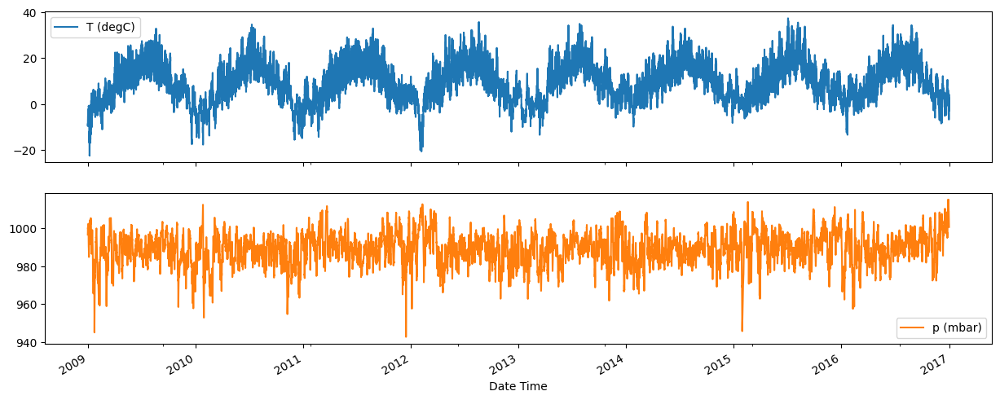

In [38]:
# lets plot the data
plot_cols = ['T (degC)', 'p (mbar)']
plot_features = df[plot_cols]
plot_features.index = date_time
_ = plot_features.plot(subplots=True)

In [39]:
# lets plot the same line plots using plotly
fig_1 = px.line(df, x=date_time, y='T (degC)')
fig_1.show()

fig_2 = px.line(df, x=date_time, y='p (mbar)')
# update traces
fig_2.update_traces(line_color='orange')
fig_2.show()

In [40]:
# lets plot the first 500 hours dataset which is equal to 250 records
df_1 = df[:250]
fig = px.line(df_1, x=date_time[:250], y='T (degC)')
fig.show()
fig = px.line(df_1, x=date_time[:250], y='p (mbar)')
fig.show()
fig = px.line(df_1, x=date_time[:250], y='wv (m/s)')
fig.show()
fig = px.line(df_1, x=date_time[:250], y='wd (deg)')
fig.show()

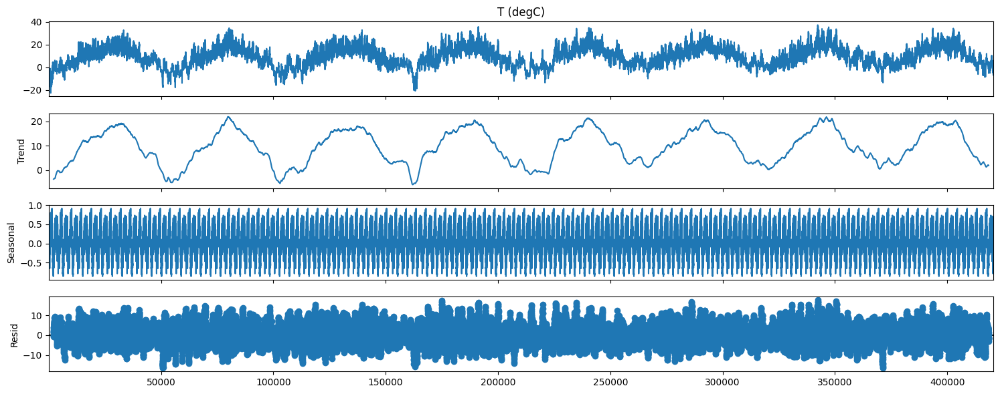

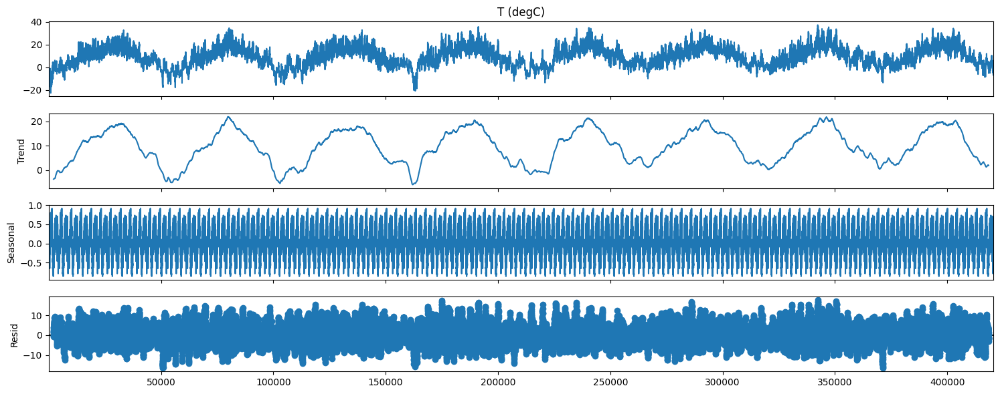

In [41]:
# lets decompose the data into trend, seasonality and noise
decompose = seasonal_decompose(df['T (degC)'], model='additive', period=365)
# plot it
decompose.plot()

In [42]:
# Decompose the time series
decompose = seasonal_decompose(df['T (degC)'], model='additive', period=365)

# Prepare data for Plotly
components = {
    'Observed': decompose.observed,
    'Trend': decompose.trend,
    'Seasonal': decompose.seasonal,
    'Residual': decompose.resid
}

# Loop through each component and create a separate figure
for name, component in components.items():
    fig = go.Figure()
    fig.add_trace(go.Scatter(x=component.index, y=component, mode='lines', name=name))
    
    # Update layout for each plot
    fig.update_layout(
        title=f'{name} Component',
        xaxis_title='Date',
        yaxis_title='Temperature (°C)',
        template='plotly_white'
    )
    
    # Show the plot
    fig.show()

In [43]:
# Decompose the time series for 'p (mbar)'
decompose = seasonal_decompose(df['p (mbar)'], model='additive', period=365)

# Create separate plots for each component
components = {
    'Observed': decompose.observed,
    'Trend': decompose.trend,
    'Seasonal': decompose.seasonal,
    'Residual': decompose.resid
}

# Loop through each component and create a separate figure
for name, component in components.items():
    fig = go.Figure()
    fig.add_trace(go.Scatter(x=component.index, y=component, mode='lines', name=name))
    
    # Update layout for each plot
    fig.update_layout(
        title=f'{name} Component for Pressure (mbar)',
        xaxis_title='Date',
        yaxis_title='Pressure (mbar)',
        template='plotly_white'
    )
    
    # Show the plot
    fig.show()

In [44]:
# Decompose the time series for 'rh (%)'
decompose = seasonal_decompose(df['rh (%)'], model='additive', period=365)

# Create separate plots for each component
components = {
    'Observed': decompose.observed,
    'Trend': decompose.trend,
    'Seasonal': decompose.seasonal,
    'Residual': decompose.resid
}

# Loop through each component and create a separate figure
for name, component in components.items():
    fig = go.Figure()
    fig.add_trace(go.Scatter(x=component.index, y=component, mode='lines', name=name))
    
    # Update layout for each plot
    fig.update_layout(
        title=f'{name} Component for Relative Humidity (%)',
        xaxis_title='Date',
        yaxis_title='Relative Humidity (%)',
        template='plotly_white'
    )
    
    # Show the plot
    fig.show()

In [45]:
# clean up the data
# lets check if there are any null values in the dataset
df.isnull().sum()

p (mbar)           0
T (degC)           0
Tpot (K)           0
Tdew (degC)        0
rh (%)             0
VPmax (mbar)       0
VPact (mbar)       0
VPdef (mbar)       0
sh (g/kg)          0
H2OC (mmol/mol)    0
rho (g/m**3)       0
wv (m/s)           0
max. wv (m/s)      0
wd (deg)           0
dtype: int64

In [46]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
p (mbar),35045.0,989.213079,8.353850,942.65,984.20,989.57,994.72,1015.16
T (degC),35045.0,9.450335,8.425301,-22.50,3.36,9.43,15.49,37.28
Tpot (K),35045.0,283.492908,8.506133,251.22,277.44,283.48,289.55,311.21
Tdew (degC),35045.0,4.955012,6.729168,-24.55,0.24,5.22,10.08,22.19
rh (%),35045.0,76.006020,16.483440,13.88,65.15,79.30,89.50,100.00
VPmax (mbar),35045.0,13.577314,7.743076,0.99,7.77,11.83,17.62,63.77
VPact (mbar),35045.0,9.532714,4.181965,0.83,6.22,8.86,12.36,26.79
VPdef (mbar),35045.0,4.044542,4.902793,0.00,0.87,2.18,5.30,46.01
sh (g/kg),35045.0,6.021744,2.654692,0.52,3.92,5.60,7.81,17.13
H2OC (mmol/mol),35045.0,9.639148,4.233082,0.83,6.29,8.97,12.49,27.25


In [47]:
wv = df['wv (m/s)']
bad_wv = wv == -9999.0  
wv[bad_wv] = 0.0

In [48]:
max_wv = df['max. wv (m/s)']
bad_max_wv = max_wv == -9999.0
max_wv[bad_max_wv] = 0.0

In [49]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
p (mbar),35045.0,989.213079,8.353850,942.65,984.20,989.57,994.72,1015.16
T (degC),35045.0,9.450335,8.425301,-22.50,3.36,9.43,15.49,37.28
Tpot (K),35045.0,283.492908,8.506133,251.22,277.44,283.48,289.55,311.21
Tdew (degC),35045.0,4.955012,6.729168,-24.55,0.24,5.22,10.08,22.19
rh (%),35045.0,76.006020,16.483440,13.88,65.15,79.30,89.50,100.00
VPmax (mbar),35045.0,13.577314,7.743076,0.99,7.77,11.83,17.62,63.77
VPact (mbar),35045.0,9.532714,4.181965,0.83,6.22,8.86,12.36,26.79
VPdef (mbar),35045.0,4.044542,4.902793,0.00,0.87,2.18,5.30,46.01
sh (g/kg),35045.0,6.021744,2.654692,0.52,3.92,5.60,7.81,17.13
H2OC (mmol/mol),35045.0,9.639148,4.233082,0.83,6.29,8.97,12.49,27.25


## **Modeling**

In [50]:
df.shape

(35045, 14)

In [51]:
# split the data into train, validation and test i have 35045 records make 70% for training, 20% for validation and 10% for testing
# 70% of 35045 is 24531
# 20% of 35045 is 7009
# 10% of 35045 is 3505
# total 35045
# train data
train_df = df[:24531]
# validation data
val_df = df[24531:31540]
# test data
test_df = df[31540:]

# lets check the shape of the data
train_df.shape, val_df.shape, test_df.shape

((24531, 14), (7009, 14), (3505, 14))

array([<Axes: >, <Axes: >, <Axes: >, <Axes: >, <Axes: >, <Axes: >,
       <Axes: >, <Axes: >, <Axes: >, <Axes: >, <Axes: >, <Axes: >,
       <Axes: >, <Axes: >], dtype=object)

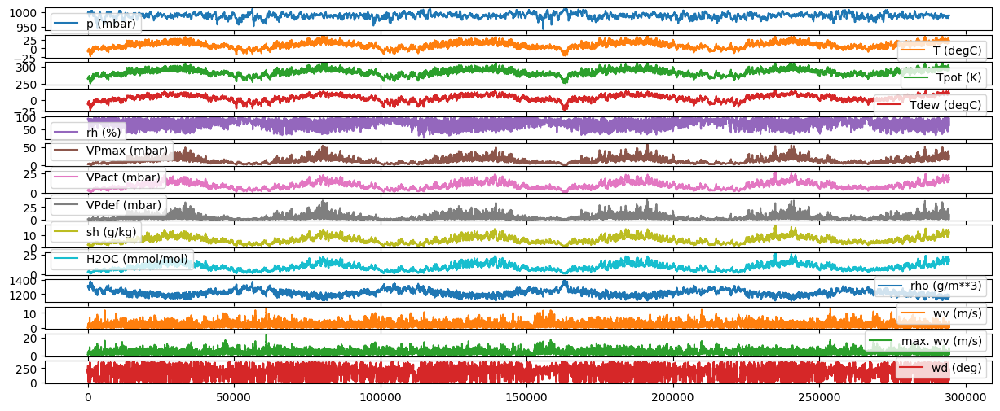

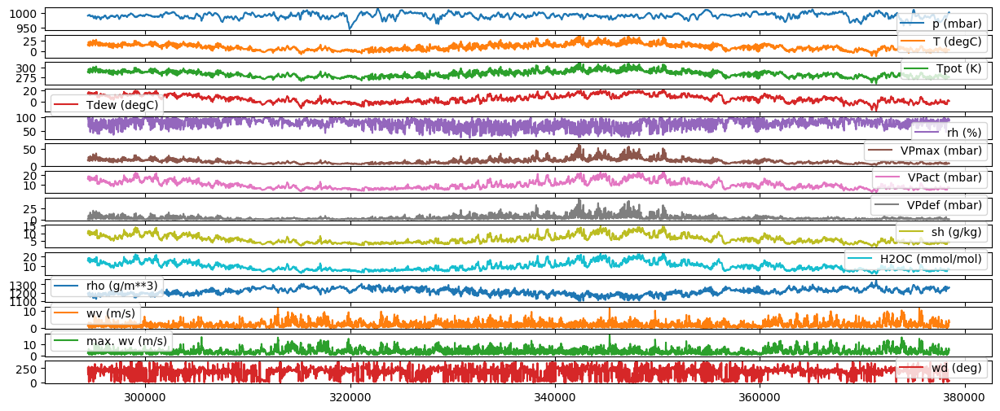

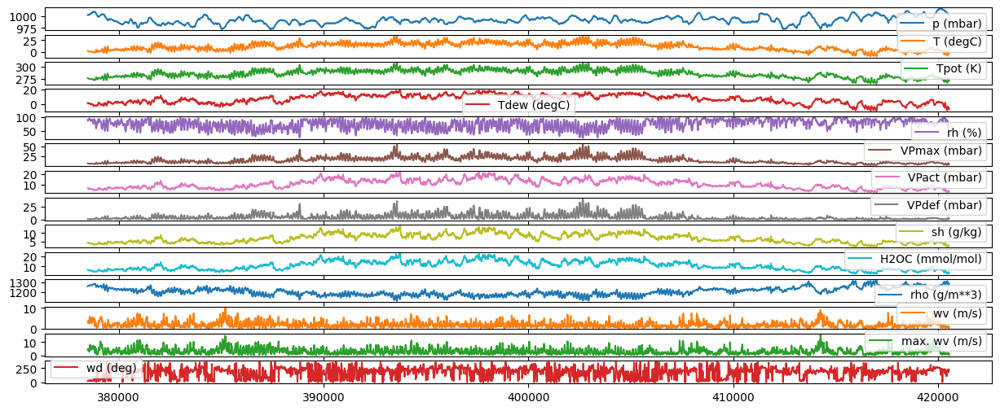

In [52]:
# lets plot the data
train_df.plot(subplots=True)

# lets plot the data
val_df.plot(subplots=True)

# lets plot the data
test_df.plot(subplots=True)

In [53]:
# lets normalize the data
# we will use the mean and standard deviation of the training data to normalize the data
train_mean = train_df.mean()
train_std = train_df.std()

# lets normalize the training data
train_df = (train_df - train_mean) / train_std
# lets normalize the validation data
val_df = (val_df - train_mean) / train_std
# lets normalize the test data
test_df = (test_df - train_mean) / train_std

array([<Axes: >, <Axes: >, <Axes: >, <Axes: >, <Axes: >, <Axes: >,
       <Axes: >, <Axes: >, <Axes: >, <Axes: >, <Axes: >, <Axes: >,
       <Axes: >, <Axes: >], dtype=object)

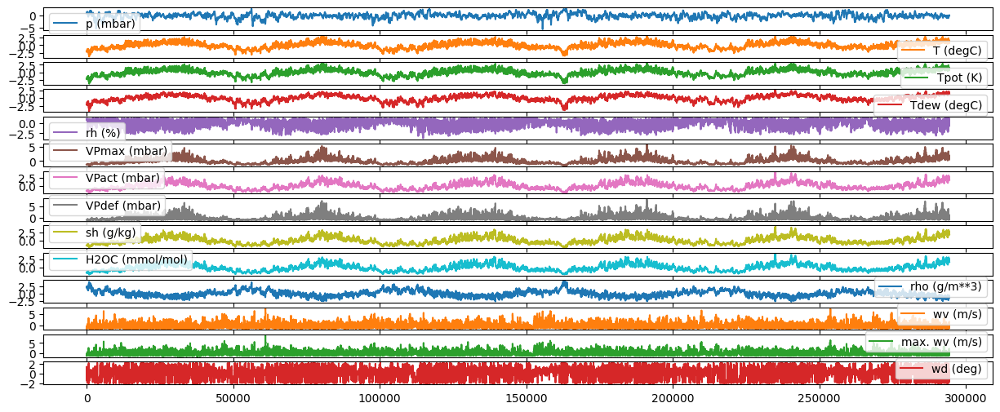

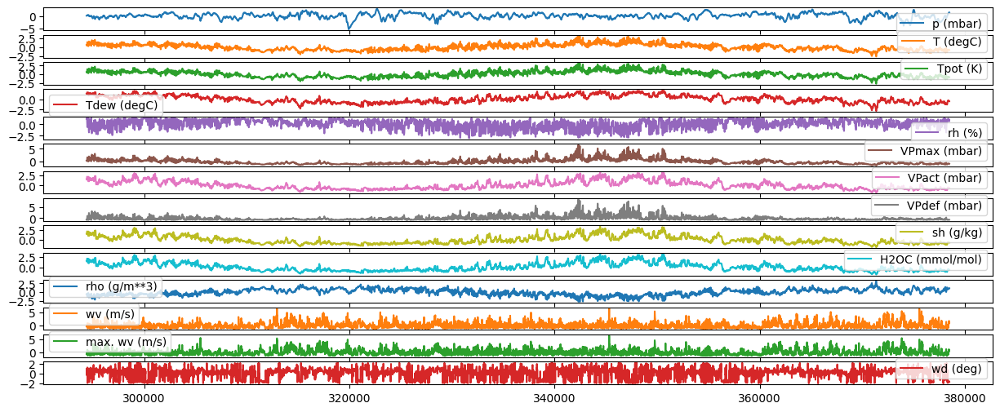

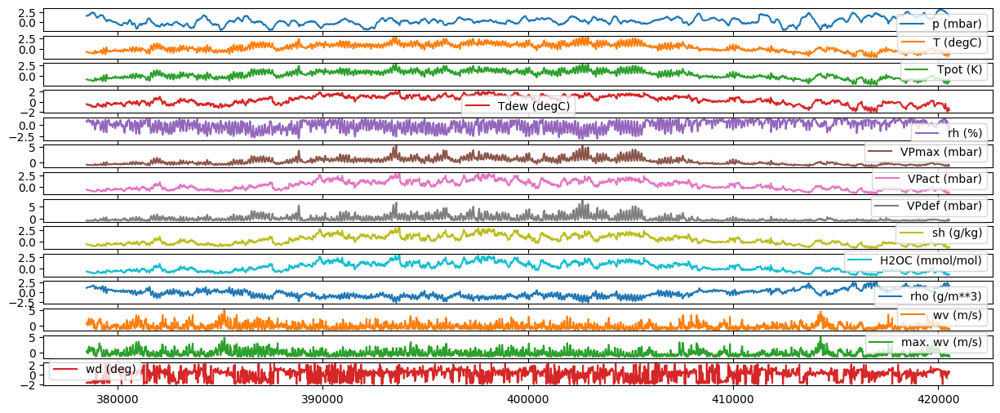

In [54]:
# lets plot the data
train_df.plot(subplots=True)

# lets plot the data
val_df.plot(subplots=True)

# lets plot the data
test_df.plot(subplots=True)

In [55]:
# Create subplots
fig = make_subplots(rows=3, cols=1, subplot_titles=("Train Data", "Validation Data", "Test Data"))

# Add traces for train_df
for column in train_df.columns:
    fig.add_trace(go.Scatter(x=train_df.index, y=train_df[column], mode='lines+markers', name=f'Train {column}',
                             line=dict(color='blue' if column == 'A' else 'orange')),
                  row=1, col=1)

# Add traces for val_df
for column in val_df.columns:
    fig.add_trace(go.Scatter(x=val_df.index, y=val_df[column], mode='lines+markers', name=f'Validation {column}',
                             line=dict(color='red' if column == 'A' else 'green')),
                  row=2, col=1)

# Add traces for test_df
for column in test_df.columns:
    fig.add_trace(go.Scatter(x=test_df.index, y=test_df[column], mode='lines+markers', name=f'Test {column}',
                             line=dict(color='purple' if column == 'A' else 'cyan')),
                  row=3, col=1)

# Update layout
fig.update_layout(title='Data Plots',
                  height=800)

# Show the plot
fig.show()